In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# 작업 디렉토리 설정
import os
wd = '/content/drive/MyDrive/광진구 공모전 DB/광진구 공모전 데이터'
os.chdir(wd)
os.getcwd()

'/content/drive/.shortcut-targets-by-id/1x0l2MxUZZl6XKOnBiXhTarE4yqgw4tkg/광진구 공모전 데이터'

In [ ]:
import pandas as pd

In [ ]:
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
fm.fontManager.addfont('/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf')
plt.rc('font', family='NanumBarunGothic')

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  fonts-nanum
0 upgraded, 1 newly installed, 0 to remove and 34 not upgraded.
Need to get 10.3 MB of archives.
After this operation, 34.1 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 fonts-nanum all 20200506-1 [10.3 MB]
Fetched 10.3 MB in 2s (6,144 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package fonts-nanum.
(Reading database ... 126101 files and dire

#1. Binary Decision Tree(공원 Point별 데이터)

In [ ]:
df_point = pd.read_excel('최종_학습용_데이터(Point별).xlsx')
df_point.head(2)

,Unnamed: 0,공원명,어린이공원_여부,geometry,격자_ID,초등학교_수,유치원_수,지역아동센터_수,키즈카페_수,청소년유해업소_수,공영주차장_수,노인복지시설_수,공시지가,유소년_인구수,노인_인구수,인근공원_수,평균_기울기
0,0,성화공원,1,POINT (205467.26755201514 448524.4926741871),6,0,15,8,0,94,5,2,4.904999e+07,304,718,9,127.920
1,1,양마장공원,1,POINT (207842.5029215506 447934.0791993207),989,18,20,1,0,10,5,25,6.102262e+07,178,721,23,329.745


In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# 입력 변수 선택
feature_cols = df_point.loc[:, '초등학교_수':'평균_기울기'].columns
X = df_point[feature_cols]
y = df_point['어린이공원_여부']


# 학습/검증 데이터 분할
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42, stratify=y)

# 이진결정트리 학습
clf = DecisionTreeClassifier(max_depth=4, random_state=42)  # max_depth는 필요시 조정
clf.fit(X_train, y_train)

# 모델 평가
y_pred = clf.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         3
           1       0.75      0.90      0.82        10

    accuracy                           0.69        13
   macro avg       0.38      0.45      0.41        13
weighted avg       0.58      0.69      0.63        13



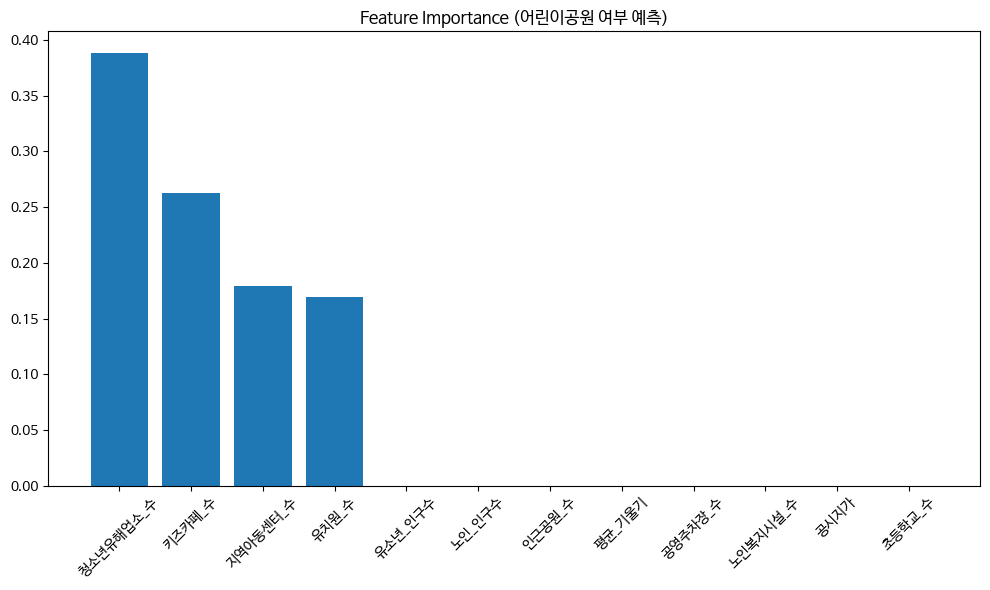

In [ ]:
# 변수 중요도 시각화
import numpy as np

importances = clf.feature_importances_
indices = np.argsort(importances)[::-1]

plt.figure(figsize=(10, 6))
plt.bar(range(len(importances)), importances[indices], align='center')
plt.xticks(range(len(importances)), [feature_cols[i] for i in indices], rotation=45)
plt.title("Feature Importance (어린이공원 여부 예측)")
plt.tight_layout()
plt.show()

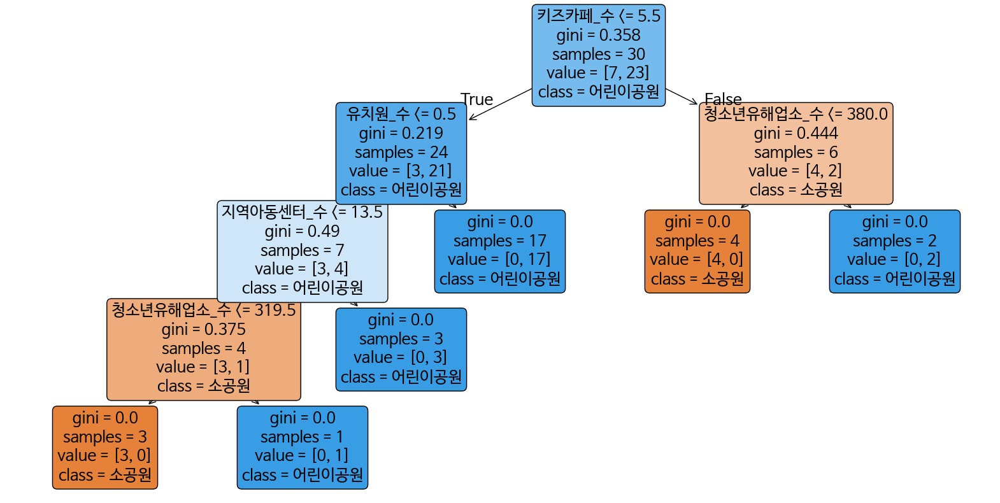

In [ ]:
# 결정트리 시각화
plt.figure(figsize=(20, 10))
plot_tree(clf, feature_names=feature_cols, class_names=['소공원', '어린이공원'],
          filled=True, rounded=True)
plt.show()

## 결과 해석
---
### 지표 설명
 * precision(정밀도): Positive로 예측한 것 중에서 실제로 Positive인 것들의 비율
 * recall(재현율): 실제로 Positive인 것 중에서 Positive로 예측한 비율
 * f1-score: 정밀도와 재현율의 조화 평균 (균형 평가 지표)
 * support:	각 클래스(0, 1)별 실제 샘플 수
 * accuracy:	전체 예측 중 모델이 정확하게 맞힌 비율
 * macro avg:	클래스별 평가지표의 단순 평균
 * weighted avg:	클래스별 sample 수를 가중치로 준 평균

### 클래스별 성능 해석
 * 클래스 0: 소공원 → 정밀도, 재현율, f1-score로 보아 모델이 소공원을 전혀 맞추지 못함
 * 클래스 1: 어린이공원 → 어린이공원은 꽤 잘 맞춤

### 지표 해석

 * accuracy = 0.69 (≈ 69%) → 전체 예측의 69%가 맞았으나, 대부분 어린이공원만 잘 맞춘 결과
 * macro avg = (0.38 / 0.45 / 0.41) → 두 클래스를 동등하게 중요하게 생각했을 때는 성능이 많이 떨어짐
 * weighted avg = (0.58 / 0.69 / 0.63) → 표본 수가 많은 어린이공원(10개) 위주로 평균을 냈을 때 성능이 괜찮아 보임



### 🔥 데이터 불균형 문제 존재
---
 * 소공원이 3개, 어린이공원이 10개로 비율이 1:3.3
 * 때문에 모델이 소공원(0)을 무시하고 1만 예측해도 점수가 괜찮게 나오는 것



### 💧 문제 해결
---

**1.   데이터 불균형 보정**

 * class_weight='balanced' 옵션 추가
 * SMOTE 등의 오버샘플링 기법 고려

**2.   트리 깊이 조정 또는 다른 모델도 테스트**
 * max_depth를 늘려 트리 분기 다양화
 * RandomForestClassifier, XGBoostClassifier 등으로 비교

**3.   평가지표 중심으로 튜닝(문제의 목적에 가장 부합하는 지표를 중심으로 모델을 평가·최적화)**
 * 정확도(Accuracy) 중심 튜닝
  * 전체 예측 중 맞춘 비율만 높이려는 방향
  * 데이터가 불균형할 경우 쓸모없을 수도 있음

 * 정밀도(Precision) 중심 튜닝
  * 예측한 결과 중에서 실제로 맞은 비율이 중요할 경우
  * 오탐(False Positive)을 줄이고 싶을 때 사용

 * 재현율(Recall) 중심 튜닝
  * 실제 Positive 클래스 중 예측에 성공한 비율이 중요할 때
  * 놓치지 않는 게 중요한 경우에 사용(예: 질병 진단, 공원 설계도 해당될 수 있음)

 * F1-score 중심 튜닝
  * 정밀도와 재현율을 균형 있게 고려
  * 불균형 데이터에서 성능을 종합적으로 판단할 때 유용

---
우리 문제의 경우, 모델이 어린이공원 설치가 필요한 입지를 '놓치는' 것이 더 치명적 → Recall이나 F1-score 중심 튜닝이 더 의미 있을 수 있음

#2. Binary Decision Tree(공원 Polygon별 데이터)


In [ ]:
df_polygon = pd.read_excel('최종_학습용_데이터(Polygon별).xlsx')
df_polygon = df_polygon.rename(columns={'Unnamed: 0': '공원_ID'})
df_polygon.head()

,공원_ID,공원명,어린이공원_여부,geometry,Point_격자_ID,격자_ID,초등학교_수,유치원_수,지역아동센터_수,키즈카페_수,청소년유해업소_수,공영주차장_수,노인복지시설_수,공시지가,유소년_인구수,노인_인구수,인근공원_수,평균_기울기
0,0,성화공원,1,POINT (205467.26755201514 448524.4926741871),6,4,0,1,1,0,3,1,0,4.902655e+06,23,103,1,13.85
1,0,성화공원,1,POINT (205467.26755201514 448524.4926741871),6,5,0,1,1,0,8,1,0,4.484785e+06,8,117,1,14.25
2,0,성화공원,1,POINT (205467.26755201514 448524.4926741871),6,6,0,2,1,0,9,1,0,4.684056e+06,0,36,1,13.64
3,0,성화공원,1,POINT (205467.26755201514 448524.4926741871),6,7,0,2,1,0,8,0,0,5.930163e+06,0,0,1,13.62
4,0,성화공원,1,POINT (205467.26755201514 448524.4926741871),6,8,0,2,1,0,8,0,0,7.363236e+06,259,267,1,14.10


In [ ]:
df_polygon.shape

(802, 18)

In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# 입력 변수 선택
feature_cols = df_polygon.loc[:, '초등학교_수':'평균_기울기'].columns
X = df_polygon[feature_cols]
y = df_polygon['어린이공원_여부']


# 학습/검증 데이터 분할
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=33, stratify=y)

# 이진결정트리 학습
clf2 = DecisionTreeClassifier(max_depth=4, random_state=33)  # max_depth는 필요시 조정
clf2.fit(X_train, y_train)

# 모델 평가
y_pred = clf2.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.63      0.20      0.30        60
           1       0.78      0.96      0.86       181

    accuracy                           0.77       241
   macro avg       0.71      0.58      0.58       241
weighted avg       0.75      0.77      0.72       241



## 결과 해석

---

“공원 반경 250m를 포함하는 격자 데이터”를 사용함으로써, 단일 지점 중심보다는 주변 환경 전반을 반영한 공간적 맥락에서 분석 → 현실적인 입지 분석 관점에서 보다 타당한 접근

---

### 지표 해석

 * 전체 정확도(accuracy): 77% → 괜찮아 보이지만, 거의 어린이공원 예측에 의한 결과

 * Recall(재현율): 어린이공원(1)은 거의 다 맞춤(96%), 소공원(0)은 거의 못 맞춤 (20%) → 여전히 모델이 어린이공원 편향

 * Macro avg vs Weighted avg
  * macro avg f1: 0.58 → 두 클래스를 동등하게 평가했을 때의 평균
  * weighted avg f1: 0.72 → 표본 수가 많은 어린이공원 위주의 평균
  * 두 지표의 차이 또한 데이터 불균형 영향을 보여줌

In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# 입력 변수 선택
feature_cols = df_polygon.loc[:, '초등학교_수':'평균_기울기'].columns
X = df_polygon[feature_cols]
y = df_polygon['어린이공원_여부']


# 학습/검증 데이터 분할
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=33, stratify=y)

# 이진결정트리 학습
clf3 = DecisionTreeClassifier(max_depth=4, class_weight='balanced', random_state=33)
clf3.fit(X_train, y_train)

# 모델 평가
y_pred = clf3.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.32      0.87      0.47        60
           1       0.90      0.39      0.55       181

    accuracy                           0.51       241
   macro avg       0.61      0.63      0.51       241
weighted avg       0.75      0.51      0.53       241



#XGBoost(공원 Polygon별 데이터)

In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report


#  입력 변수 선택
feature_cols = df_polygon.loc[:, '초등학교_수':'평균_기울기'].columns
X = df_polygon[feature_cols]
y = df_polygon['어린이공원_여부']

# 학습/검증 데이터 분할
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=33, stratify=y)

# (★★ 선정) 모델 정의
xgb_clf = XGBClassifier(
    n_estimators=100,
    max_depth=6,
    eval_metric='logloss',  # 꼭 지정!
    random_state=33
)
xgb_clf.fit(X_train, y_train)

# 예측 및 평가
y_pred_xgb = xgb_clf.predict(X_test)
print("⚡ XGBoost 결과")
print(classification_report(y_test, y_pred_xgb))

⚡ XGBoost 결과
              precision    recall  f1-score   support

           0       0.46      0.40      0.43        60
           1       0.81      0.85      0.83       181

    accuracy                           0.73       241
   macro avg       0.64      0.62      0.63       241
weighted avg       0.72      0.73      0.73       241



## Hyper-Parameter Tuning
### RandomizedSearchCV

In [ ]:
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from sklearn.metrics import accuracy_score
import numpy as np

# 1.입력 변수 선택
# feature_cols = df_polygon.loc[:, '초등학교_수':'평균_기울기'].columns
# X = df_polygon[feature_cols]
# y = df_polygon['어린이공원_여부']

# 2. 데이터 분리
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=35, stratify=y)

# 3. 파라미터 후보 설정
param_dist = {
    'learning_rate': [0.01, 0.05, 0.1],  # learning_rate를 낮추면 더 많은 트리가 필요
    'max_depth': [3, 4, 5, 6],
    'min_child_weight': [1, 3, 5],
    'gamma': [0, 0.1, 0.2, 0.3],  # 트리 분할을 허용할 최소 손실 감소량, 크면 트리 분할이 덜 일어나고, 과적합 방지
    'subsample': [0.7, 0.8, 0.9, 1.0],  # 각 트리 학습에 사용하는 데이터 샘플 비율, 낮추면 모델이 더 랜덤해지고 과적합이 줄어듦
    'colsample_bytree': [0.7, 0.8, 0.9, 1.0],  # 각 트리 학습에 사용하는 피처(컬럼) 비율, 낮추면 모델이 더 랜덤해지고 과적합이 줄어듦
    'reg_alpha': [0, 0.01, 0.1],  # (L1 규제): 모델을 좀 더 sparse하게 만듦 (중요하지 않은 특성 제거)
    'reg_lambda': [1, 1.5, 2]  # (L2 규제): 기본적으로 쓰고, 너무 과적합이면 더 키우기
}

# 4. 모델
xgb = XGBClassifier(
    n_estimators=300,
    objective='binary:logistic',
    eval_metric='logloss',
    use_label_encoder=False,
    random_state=35
)

# 5. Random SearchCV
random_search = RandomizedSearchCV(
    estimator=xgb,
    param_distributions=param_dist,
    n_iter=30,  # 30번 랜덤 조합 시도
    scoring='accuracy',   # 정확도 기반 평가
    cv=3,                 # 3-Fold 교차검증
    verbose=2,
    random_state=35,
    n_jobs=-1
)

# 주의: 여기서는 early_stopping 없이 fit
random_search.fit(X_train, y_train)

# 6. 결과
print("Best Parameters:", random_search.best_params_)
print("Best CV Score:", random_search.best_score_)

best_params = random_search.best_params_

Fitting 3 folds for each of 30 candidates, totalling 90 fits
Best Parameters: {'subsample': 0.8, 'reg_lambda': 1, 'reg_alpha': 0.01, 'min_child_weight': 3, 'max_depth': 5, 'learning_rate': 0.01, 'gamma': 0.3, 'colsample_bytree': 1.0}
Best CV Score: 0.7909920582686149


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [14:09:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


### CV(교차검증)에서 가장 높은 성능을 보인 파라미터 세트
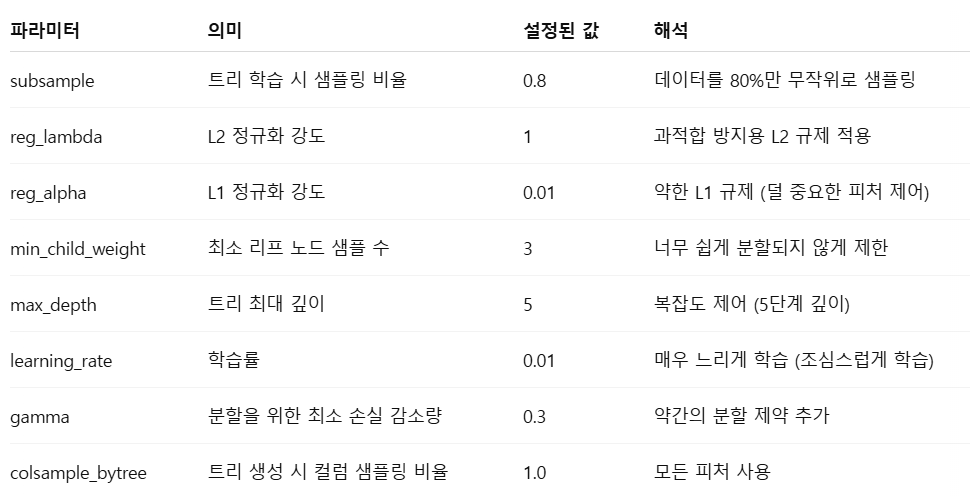

In [ ]:
import xgboost as xgb

# train+val 합치기
X_full = np.vstack((X_train, X_val))
y_full = np.hstack((y_train, y_val))

# 다시 validation set을 분할 (early stopping을 위해)
X_full_train, X_full_val, y_full_train, y_full_val = train_test_split(
    X_full, y_full, test_size=0.2, random_state=35, stratify=y_full
)

# DMatrix로 변환 (xgboost 전용 데이터 포맷)
dtrain = xgb.DMatrix(X_full_train, label=y_full_train, feature_names=X.columns.tolist())
dval = xgb.DMatrix(X_full_val, label=y_full_val, feature_names=X.columns.tolist())

# 최적 파라미터 적용
params = {
    'objective': 'binary:logistic',
    'learning_rate': best_params['learning_rate'],
    'max_depth': best_params['max_depth'],
    'min_child_weight': best_params['min_child_weight'],
    'gamma': best_params['gamma'],
    'subsample': best_params['subsample'],
    'colsample_bytree': best_params['colsample_bytree'],
    'reg_alpha': best_params['reg_alpha'],
    'reg_lambda': best_params['reg_lambda'],
    'eval_metric': 'logloss'
}

# 학습 + early stopping
evals = [(dtrain, 'train'), (dval, 'eval')]
evals_result = {}

final_model = xgb.train(
    params,
    dtrain,
    num_boost_round=1000,           # 트리 최대 1000개까지
    evals=evals,
    early_stopping_rounds=30,       # 30회 개선 없으면 조기 종료
    evals_result=evals_result,
    verbose_eval=True
)

# validation 데이터로 예측 실행
y_pred_prob = final_model.predict(dval)
y_pred = (y_pred_prob > 0.5).astype(int)  # 확률을 0/1로 변환

# 정확도 평가(최종 성능 평가)
final_accuracy = accuracy_score(y_full_val, y_pred)
print(f"Final Validation Accuracy: {final_accuracy:.4f}")

[0]	train-logloss:0.56048	eval-logloss:0.56051
[1]	train-logloss:0.55817	eval-logloss:0.55995
[2]	train-logloss:0.55602	eval-logloss:0.55932
[3]	train-logloss:0.55426	eval-logloss:0.55840
[4]	train-logloss:0.55230	eval-logloss:0.55754
[5]	train-logloss:0.55049	eval-logloss:0.55682
[6]	train-logloss:0.54843	eval-logloss:0.55630
[7]	train-logloss:0.54681	eval-logloss:0.55537
[8]	train-logloss:0.54483	eval-logloss:0.55443
[9]	train-logloss:0.54283	eval-logloss:0.55390
[10]	train-logloss:0.54107	eval-logloss:0.55333
[11]	train-logloss:0.53894	eval-logloss:0.55276
[12]	train-logloss:0.53685	eval-logloss:0.55122
[13]	train-logloss:0.53500	eval-logloss:0.55026
[14]	train-logloss:0.53346	eval-logloss:0.54986
[15]	train-logloss:0.53154	eval-logloss:0.54905
[16]	train-logloss:0.52950	eval-logloss:0.54828
[17]	train-logloss:0.52803	eval-logloss:0.54736
[18]	train-logloss:0.52645	eval-logloss:0.54669
[19]	train-logloss:0.52453	eval-logloss:0.54622
[20]	train-logloss:0.52268	eval-logloss:0.54552
[2

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.metrics import confusion_matrix, classification_report, roc_curve

# 예측 확률 및 이진 예측
y_pred_prob = final_model.predict(dval)
y_pred = (y_pred_prob > 0.5).astype(int)

# 성능 지표 계산
metrics = {
    "Accuracy": accuracy_score(y_full_val, y_pred),
    "Precision": precision_score(y_full_val, y_pred),
    "Recall": recall_score(y_full_val, y_pred),
    "F1-score": f1_score(y_full_val, y_pred),
    "ROC AUC": roc_auc_score(y_full_val, y_pred_prob)
}

# DataFrame으로 만들기
metrics_df = pd.DataFrame.from_dict(metrics, orient='index', columns=['Score']).reset_index()
metrics_df.columns = ['Metric', 'Score']

# 출력
display(metrics_df)

,Metric,Score
0,Accuracy,0.776398
1,Precision,0.793103
2,Recall,0.950413
3,F1-score,0.864662
4,ROC AUC,0.805682


### 가중합 점수 계산
1) Feature Importance는 모델이 학습을 통해 직접 발견한 의미 있는 정보
 * XGBoost는 각 분기 기준으로 얼마나 많은 정보 이득을 가져오는지를 기반으로 변수 중요도를 계산함 = 구분짓는 데 대한 기여도 반영
 * 즉, 모델이 데이터에 기반해서 "이런 특성들이 중요하다"고 판단한 결과

2) 반면, 가중합 점수는 연속적인 스코어로, 후보지를 세밀하게 서열화할 수 있음
 * 예측 확률 대신, 입지 평가를 위한 점수를 만드는 데 사용할 수 있음.
 * 모델 예측은 이분법적 결과(설치 필요/불필요)이나, 현실에서는 "설치할까 말까"뿐 아니라 "여기는 정말 좋고, 저기는 보통이고" 같은 우선순위를 정해야 하므로 유용함

3) 총합 1로 맞추는 정규화도 합리적
 * 단순히 raw importance를 사용하는 것보다, 총합 1로 정규화하면 가중합 점수가 "상대적 중요도 비율"을 명확히 반영
 * 격자별 점수를 비교할 때 해석이 쉬워지고, 다른 지표들과 결합(예: 설치 필요 확률과 합성)하기도 편해짐

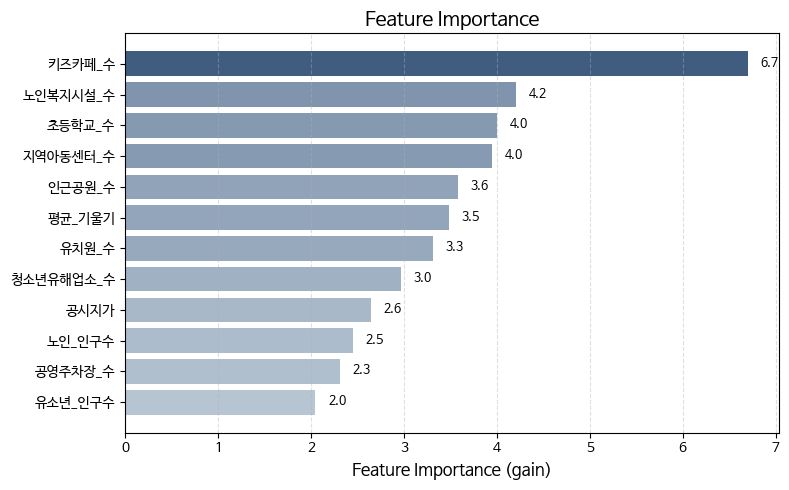

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

importance_gain = final_model.get_score(importance_type='gain')

# 중요도 정렬
keys_gain = list(importance_gain.keys())
values_gain = list(importance_gain.values())
sorted_idx = np.argsort(values_gain)[::-1]
keys_sorted = np.array(keys_gain)[sorted_idx]
values_sorted = np.array(values_gain)[sorted_idx]

# 색상 정의: 연한 회청색 → 진한 파랑색
base_color = (183, 197, 211)
dark_color = (64, 93, 128)

def rgb_to_hex(rgb):
    return '#%02x%02x%02x' % tuple(rgb)

cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", [
    rgb_to_hex(base_color),
    rgb_to_hex(dark_color)
])

# 색상 매핑
norm = plt.Normalize(min(values_sorted), max(values_sorted))
colors = [cmap(norm(val)) for val in values_sorted]

# 시각화
plt.figure(figsize=(8, 5))
bars = plt.barh(keys_sorted, values_sorted, color=colors)
plt.xlabel('Feature Importance (gain)', fontsize=12)
plt.title('Feature Importance', fontsize=14)
plt.gca().invert_yaxis()
plt.grid(axis='x', linestyle='--', alpha=0.4)

# 값 라벨 추가
for bar in bars:
    width = bar.get_width()
    plt.text(width + max(values_sorted)*0.02, bar.get_y() + bar.get_height()/2,
             f'{width:.1f}', va='center', fontsize=9)

plt.tight_layout()
plt.show()

In [ ]:
# Feature Importance 가져오기
importance = final_model.get_score(importance_type='gain')

# 딕셔너리를 Series로 변환
importance_series = pd.Series(importance)

# 중요도 총합 1로 정규화
weight_series = importance_series / importance_series.sum()
weight_series.name = 'weight'

# 정렬 후 DataFrame으로 변환
weight_df = weight_series.sort_values(ascending=False).to_frame()
display(weight_df)

,weight
키즈카페_수,0.160860
노인복지시설_수,0.101082
초등학교_수,0.096065
지역아동센터_수,0.094835
인근공원_수,0.085893
평균_기울기,0.083637
유치원_수,0.079437
청소년유해업소_수,0.071293
공시지가,0.063399
노인_인구수,0.058908


---
# 광진구 어린이공원 최적 입지 예측

In [ ]:
df_predict = pd.read_csv('/content/drive/MyDrive/광진구 공모전 DB/광진구 공모전 데이터/최종_예측용_데이터(ver.2).csv')
df_predict.head(2)

,gid,lbl,val,geometry,centroid,초등학교_수,유치원_수,지역아동센터_수,키즈카페_수,청소년유해업소_수,공영주차장_수,노인복지시설_수,공시지가,유소년_인구수,노인_인구수,인근공원_수,평균_기울기
0,다사633494,15.0,15.0,"POLYGON ((207472.6374276429 449302.0014346186,...",POINT (207522.38994695604 449352.2859289683),0.0,1.0,0.0,0.0,0.0,0.0,0.0,4.801408e+06,15.0,47.0,0.0,21.55
1,다사626517,18.0,18.0,POLYGON ((206760.1403713964 451599.12708423263...,POINT (206809.89272686283 451649.411664678),0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.813924e+06,18.0,48.0,0.0,15.32


In [ ]:
df_predict = df_predict.drop(columns=['lbl', 'val'])

In [ ]:
feature_cols = ['초등학교_수', '유치원_수', '지역아동센터_수', '키즈카페_수', '청소년유해업소_수',
                '공영주차장_수', '노인복지시설_수', '공시지가', '유소년_인구수',
                '노인_인구수', '인근공원_수', '평균_기울기']

# 예측용 DMatrix 생성
dmatrix_predict = xgb.DMatrix(df_predict[feature_cols], feature_names=feature_cols)

# 설치 필요 확률 예측
predicted_prob = final_model.predict(dmatrix_predict)

# 예측 결과 저장
df_predict['어린이공원_설치_예측'] = (predicted_prob >= 0.5).astype(int)
df_predict['설치_필요_확률'] = predicted_prob
df_predict.head(10)

,gid,geometry,centroid,초등학교_수,유치원_수,지역아동센터_수,키즈카페_수,청소년유해업소_수,공영주차장_수,노인복지시설_수,공시지가,유소년_인구수,노인_인구수,인근공원_수,평균_기울기,어린이공원_설치_예측,설치_필요_확률
0,다사633494,"POLYGON ((207472.6374276429 449302.0014346186,...",POINT (207522.38994695604 449352.2859289683),0.0,1.0,0.0,0.0,0.0,0.0,0.0,4.801408e+06,15.0,47.0,0.0,21.550,0,0.442187
1,다사626517,POLYGON ((206760.1403713964 451599.12708423263...,POINT (206809.89272686283 451649.411664678),0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.813924e+06,18.0,48.0,0.0,15.320,1,0.780265
2,다사642512,POLYGON ((208363.39366657657 451107.4571299241...,POINT (208413.1461359775 451157.74177095306),0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.109825e+06,30.0,101.0,0.0,54.270,1,0.898357
3,다사647489,POLYGON ((208875.81637008948 448809.2632527317...,POINT (208925.56899254632 448859.5477967318),0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.578754e+06,71.0,26.0,0.0,15.170,1,0.811685
4,다사640506,POLYGON ((208166.51229669116 450506.1702789996...,POINT (208216.26478813996 450556.4548766172),0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.854859e+06,23.0,116.0,0.0,43.250,1,0.943502
5,다사634493,POLYGON ((207573.20641095412 449202.4963868814...,POINT (207622.95894115846 449252.780881299),0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.162205e+06,7.0,29.0,0.0,20.750,0,0.484197
6,다사638512,POLYGON ((207963.24532641142 451105.3284513005...,POINT (208012.99777417604 451155.6130704189),0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.670514e+06,13.0,74.0,0.0,45.710,1,0.791316
7,다사621498,"POLYGON ((206270.06611438145 449695.765278029,...",POINT (206319.8185468517 449746.0497282907),0.0,0.0,0.0,0.0,2.0,0.0,0.0,6.621255e+06,12.0,52.0,0.0,20.430,1,0.574752
8,다사618486,POLYGON ((205976.33893112344 448493.7270683613...,POINT (206026.0914130885 448544.0114372479),0.0,0.0,0.0,0.0,0.0,0.0,1.0,5.586949e+06,85.0,215.0,0.0,13.955,1,0.784309
9,다사638480,POLYGON ((207980.26917632401 447904.1423918965...,POINT (208030.0217993988 447954.42683788494),0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.455149e+06,26.0,148.0,0.0,22.100,1,0.765872


In [ ]:
df_predict[['gid', 'geometry', '어린이공원_설치_예측', '설치_필요_확률']].head(10)

,gid,geometry,어린이공원_설치_예측,설치_필요_확률
0,다사633494,"POLYGON ((207472.6374276429 449302.0014346186,...",0,0.442187
1,다사626517,POLYGON ((206760.1403713964 451599.12708423263...,1,0.780265
2,다사642512,POLYGON ((208363.39366657657 451107.4571299241...,1,0.898357
3,다사647489,POLYGON ((208875.81637008948 448809.2632527317...,1,0.811685
4,다사640506,POLYGON ((208166.51229669116 450506.1702789996...,1,0.943502
5,다사634493,POLYGON ((207573.20641095412 449202.4963868814...,0,0.484197
6,다사638512,POLYGON ((207963.24532641142 451105.3284513005...,1,0.791316
7,다사621498,"POLYGON ((206270.06611438145 449695.765278029,...",1,0.574752
8,다사618486,POLYGON ((205976.33893112344 448493.7270683613...,1,0.784309
9,다사638480,POLYGON ((207980.26917632401 447904.1423918965...,1,0.765872


In [ ]:
# feature_cols = ['초등학교_수', '유치원_수', '지역아동센터_수', '키즈카페_수', '청소년유해업소_수',
#                 '공영주차장_수', '노인복지시설_수', '공시지가', '유소년_인구수',
#                 '노인_인구수', '인근공원_수', '평균_기울기']

# # 예측용 X 생성
# X_predict = df_predict[feature_cols]

# # 예측 실행
# df_predict['어린이공원_예측'] = xgb_clf.predict(X_predict)
# df_predict['설치_필요_확률'] = xgb_clf.predict_proba(X_predict)[:, 1]

### 최적 입지 판단 지표 도출

#### 가중합 점수 도출을 위한 정규화(변수 방향성 고려)

In [ ]:
# 1. 방향성 설정
reverse_vars = ['청소년유해업소_수', '공시지가', '평균_기울기', '인근공원_수']

# 2. 정규화 함수 정의
def normalize_series(s, reverse=False):
    if reverse:
        return (s.max() - s) / (s.max() - s.min())
    else:
        return (s - s.min()) / (s.max() - s.min())

# 3. 정규화 적용 및 정규화된 변수 저장
df_norm = df_predict.copy()
normalized_cols = []

for var in weight_series.index:
    reverse = var in reverse_vars
    col_name = f'{var}_norm'
    df_norm[col_name] = normalize_series(df_predict[var], reverse=reverse)
    normalized_cols.append(col_name)

# 4. 정규화된 변수 × 가중치 → 최종 가중합 점수 계산
#    (정규화된 변수명과 가중치 이름을 매칭)
final_score = 0
for var in weight_series.index:
    final_score += df_norm[f'{var}_norm'] * weight_series[var]

df_norm['최종_가중합_점수'] = final_score

In [ ]:
df_norm[['gid', '설치_필요_확률', '최종_가중합_점수']].sort_values('최종_가중합_점수', ascending=False).head(10)

,gid,설치_필요_확률,최종_가중합_점수
471,다사629519,0.852631,0.470093
679,다사625479,0.835940,0.467603
87,다사629486,0.832572,0.464155
37,다사631518,0.822790,0.463246
995,다사645495,0.930566,0.461208
1046,다사635501,0.909443,0.451840
1805,다사636520,0.955142,0.450536
1065,다사637480,0.888374,0.450216
993,다사629493,0.912905,0.449882
1583,다사633518,0.055447,0.449534


In [ ]:
# 설치 필요 확률 + 가중합 점수 = 합성 최종 스코어 계산
df_norm['합성_스코어'] = 0.5 * df_norm['최종_가중합_점수'] + 0.5 * df_norm['설치_필요_확률']
df_norm.head(10)

,gid,geometry,centroid,초등학교_수,유치원_수,지역아동센터_수,키즈카페_수,청소년유해업소_수,공영주차장_수,노인복지시설_수,...,청소년유해업소_수_norm,공영주차장_수_norm,노인복지시설_수_norm,공시지가_norm,유소년_인구수_norm,노인_인구수_norm,인근공원_수_norm,평균_기울기_norm,최종_가중합_점수,합성_스코어
0,다사633494,"POLYGON ((207472.6374276429 449302.0014346186,...",POINT (207522.38994695604 449352.2859289683),0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.586225,0.050000,0.116049,1.0,0.939337,0.361647,0.401917
1,다사626517,POLYGON ((206760.1403713964 451599.12708423263...,POINT (206809.89272686283 451649.411664678),0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.757502,0.060000,0.118519,1.0,0.959322,0.295378,0.537822
2,다사642512,POLYGON ((208363.39366657657 451107.4571299241...,POINT (208413.1461359775 451157.74177095306),0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.904358,0.100000,0.249383,1.0,0.834371,0.303914,0.601136
3,다사647489,POLYGON ((208875.81637008948 448809.2632527317...,POINT (208925.56899254632 448859.5477967318),0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.777768,0.236667,0.064198,1.0,0.959804,0.302192,0.556938
4,다사640506,POLYGON ((208166.51229669116 450506.1702789996...,POINT (208216.26478813996 450556.4548766172),0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.667796,0.076667,0.286420,1.0,0.869723,0.292907,0.618205
5,다사634493,POLYGON ((207573.20641095412 449202.4963868814...,POINT (207622.95894115846 449252.780881299),0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.641310,0.023333,0.071605,1.0,0.941903,0.281988,0.383092
6,다사638512,POLYGON ((207963.24532641142 451105.3284513005...,POINT (208012.99777417604 451155.6130704189),0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.769861,0.043333,0.182716,1.0,0.861831,0.290970,0.541143
7,다사621498,"POLYGON ((206270.06611438145 449695.765278029,...",POINT (206319.8185468517 449746.0497282907),0.0,0.0,0.0,0.0,2.0,0.0,0.0,...,0.846154,0.0,0.0,0.429394,0.040000,0.128395,1.0,0.942930,0.261835,0.418294
8,다사618486,POLYGON ((205976.33893112344 448493.7270683613...,POINT (206026.0914130885 448544.0114372479),0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.000000,0.0,0.2,0.518528,0.283333,0.530864,1.0,0.963701,0.336084,0.560196
9,다사638480,POLYGON ((207980.26917632401 447904.1423918965...,POINT (208030.0217993988 447954.42683788494),0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.702242,0.086667,0.365432,1.0,0.937572,0.305912,0.535892


### '가중합_점수' 기준 순위와 '합성_스코어' 기준 순위 비교

In [ ]:
# 가중합 점수 기준 Top 180 추출
df_top180_weighted_score = df_norm.sort_values('최종_가중합_점수', ascending=False).head(180)

# 합성 최종 스코어 기준 Top 180 추출
df_top180_composed_score = df_norm.sort_values('합성_스코어', ascending=False).head(180)

In [ ]:
temp = df_top180_weighted_score[[ 'weighted_rank','최종_가중합_점수', 'gid']].head(180)
temp.rename(columns={'최종_가중합_점수':'가중합_점수', 'weighted_rank': 'rank'}, inplace=True)
temp

,rank,가중합_점수,gid
471,1,0.470093,다사629519
679,2,0.467603,다사625479
87,3,0.464155,다사629486
37,4,0.463246,다사631518
995,5,0.461208,다사645495
...,...,...,...
1413,176,0.304040,다사630472
1372,177,0.304040,다사629472
936,178,0.304037,다사619473
933,179,0.304029,다사634473


In [ ]:
common_gids = set(df_top180_weighted_score['gid']) & set(df_top180_composed_score['gid'])
print(f"두 top100 사이에 겹치는 gid 수: {len(common_gids)}개")

두 top100 사이에 겹치는 gid 수: 42개


In [ ]:
# rank 컬럼 생성
df_top180_weighted_score = df_top180_weighted_score.copy()
df_top180_composed_score = df_top180_composed_score.copy()

df_top180_weighted_score['weighted_rank'] = df_top180_weighted_score['최종_가중합_점수'].rank(method='first', ascending=False).astype(int)
df_top180_composed_score['composed_rank'] = df_top180_composed_score['합성_스코어'].rank(method='first', ascending=False).astype(int)

df_rank_compare = df_top180_weighted_score[['gid', 'weighted_rank']].merge(
    df_top180_composed_score[['gid', 'composed_rank']],
    on='gid',
    how='inner'  # 공통된 gid만
)

# 순위 차이 계산
df_rank_compare['rank_diff'] = abs(df_rank_compare['weighted_rank'] - df_rank_compare['composed_rank'])

# 유사도 통계 보기
print(f"겹치는 gid 수: {len(df_rank_compare)}개")
print(f"평균 순위 차이: {df_rank_compare['rank_diff'].mean():.2f}")
print(f"순위 차이가 10 이내인 항목 수: {(df_rank_compare['rank_diff'] <= 10).sum()}개")

겹치는 gid 수: 42개
평균 순위 차이: 60.02
순위 차이가 10 이내인 항목 수: 10개


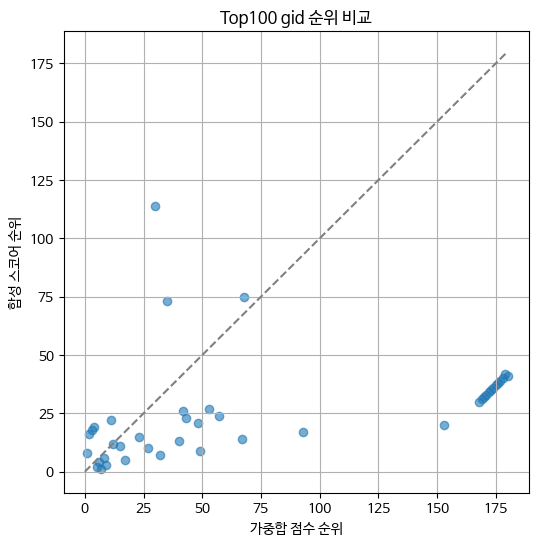

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(6, 6))
plt.scatter(df_rank_compare['weighted_rank'], df_rank_compare['composed_rank'], alpha=0.6)
plt.plot([0, 180], [0, 180], color='gray', linestyle='--')  # 완벽 일치 기준선
plt.xlabel('가중합 점수 순위')
plt.ylabel('합성 스코어 순위')
plt.title('Top100 gid 순위 비교')
plt.grid(True)
plt.show()

### 모델이 놓친 도메인 중요 요소(유소년 인구수)를 최종 점수에 반영해서 보완


*   모델과 현실 지식이 다르게 나오고 있는 상황(실무에서도 자주 일어나는 이슈)
 1. Feature Weight를 직접 수정 (Post-hoc 조정):	유소년 인구수에 인위적으로 높은 가중치를 준다.	바로 가능하며, 실용적
 2. 모델 학습 자체를 수정:	유소년 인구수를 강조하는 방향으로 데이터를 변형하거나, loss에 반영한다.	복잡하고, 실험 필요
 3. 예측 + 도메인 지식 합성 스코어 만들기:	**모델 예측을 그대로 두되, 최종 합성 점수를 계산할 때 유소년 인구수 feature에 가산점 부여**



In [ ]:
# # 1. 유소년 인구수 정규화 (0 ~ 1 스케일) → 유소년_인구수_norm은 이미 정규화 된 상태
# youth_normalized = df_norm['유소년_인구수'] / df_norm['유소년_인구수'].max()

# # 2. alpha 값 설정
# alpha = 0.3  # 원하는 반영 강도에 맞게 조정(alpha = 0.3 이면, 기존 스코어의 30% 강도로 추가 반영됨)

# # 3. 최종 스코어 = 기존 합성 스코어 + (alpha × 유소년 인구수 정규화)
# df_norm['합성_스코어_보정'] = df_norm['합성_스코어'] + alpha * youth_normalized
# df_norm.head(2)

,gid,geometry,centroid,초등학교_수,유치원_수,지역아동센터_수,키즈카페_수,청소년유해업소_수,공영주차장_수,노인복지시설_수,...,공영주차장_수_norm,노인복지시설_수_norm,공시지가_norm,유소년_인구수_norm,노인_인구수_norm,인근공원_수_norm,평균_기울기_norm,최종_가중합_점수,합성_스코어,합성_스코어_보정
0,다사633494,"POLYGON ((207472.6374276429 449302.0014346186,...",POINT (207522.38994695604 449352.2859289683),0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.586225,0.05,0.116049,1.0,0.939337,0.361647,0.401917,0.416917
1,다사626517,POLYGON ((206760.1403713964 451599.12708423263...,POINT (206809.89272686283 451649.411664678),0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.757502,0.06,0.118519,1.0,0.959322,0.295378,0.537822,0.555822


In [ ]:
# # 4. 최종 스코어 기준 정렬 (Top 180 후보 추출)
# df_top180_composed_score_2 = df_norm.sort_values('합성_스코어_보정', ascending=False).head(180)

# # 5. 결과 확인
# df_top180_composed_score_2[['유소년_인구수', '설치_필요_확률', '최종_가중합_점수', '합성_스코어', '합성_스코어_보정']].head()

,유소년_인구수,설치_필요_확률,최종_가중합_점수,합성_스코어,합성_스코어_보정
187,259.0,0.896888,0.346442,0.621665,0.880665
154,300.0,0.575200,0.339355,0.457277,0.757277
317,136.0,0.835731,0.393280,0.614505,0.750505
206,206.0,0.678070,0.317219,0.497644,0.703644
1805,0.0,0.955142,0.450536,0.702839,0.702839


#### 유소년 인구수를 가중합 점수에 반영

In [ ]:
# alpha 값 설정
alpha = 0.3

# 최종 합성 점수 계산: 도메인 가중치 (유소년 인구수 30%)
df_norm['최종_가중합_점수_보정'] = (
    (1 - alpha) * df_norm['최종_가중합_점수'] +
    alpha * df_norm['유소년_인구수_norm'])

In [ ]:
df_norm[['gid', '설치_필요_확률', '최종_가중합_점수_보정']]\
    .sort_values('최종_가중합_점수_보정', ascending=False).head(10)

,gid,설치_필요_확률,최종_가중합_점수_보정
154,다사643493,0.575200,0.537548
187,다사613488,0.896888,0.501509
686,다사647494,0.640115,0.442827
206,다사646492,0.678070,0.428053
668,다사646490,0.670257,0.421781
317,다사650494,0.835731,0.411296
792,다사648495,0.450686,0.399077
156,다사647493,0.688840,0.390796
444,다사646493,0.566559,0.381676
337,다사645490,0.657584,0.372288


In [ ]:
# alpha 값 설정
alpha = 0.2

# 최종 합성 점수 계산: 도메인 가중치 (유소년 인구수 30%)
df_norm['최종_가중합_점수_보정_0.2'] = (
    (1 - alpha) * df_norm['최종_가중합_점수'] +
    alpha * df_norm['유소년_인구수_norm'])

In [ ]:
df_norm[['gid', '설치_필요_확률', '최종_가중합_점수_보정_0.2']]\
    .sort_values('최종_가중합_점수_보정_0.2', ascending=False).head(10)

,gid,설치_필요_확률,최종_가중합_점수_보정_0.2
154,다사643493,0.575200,0.471484
187,다사613488,0.896888,0.449820
317,다사650494,0.835731,0.405290
686,다사647494,0.640115,0.404183
471,다사629519,0.852631,0.391408
206,다사646492,0.678070,0.391108
668,다사646490,0.670257,0.388226
87,다사629486,0.832572,0.385324
679,다사625479,0.835940,0.382749
37,다사631518,0.822790,0.381930


In [ ]:
# # alpha 값 튜닝
# alpha = 0.5  # 원하는 반영 강도에 맞게 조정(alpha = 0.3 이면, 기존 스코어의 30% 강도로 추가 반영됨)
# df_predict['합성_스코어_보정_0.5'] = df_predict['합성_스코어'] + alpha * youth_normalized
# df_top100_composed_score_3 = df_predict.sort_values('합성_스코어_보정_0.5', ascending=False).head(50)

### 대망의 시각화

In [ ]:
df_norm_copy = df_norm.copy()

In [ ]:
df_norm_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1812 entries, 0 to 1811
Data columns (total 33 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   gid               1812 non-null   object 
 1   geometry          1812 non-null   object 
 2   centroid          1812 non-null   object 
 3   초등학교_수            1812 non-null   float64
 4   유치원_수             1812 non-null   float64
 5   지역아동센터_수          1812 non-null   float64
 6   키즈카페_수            1812 non-null   float64
 7   청소년유해업소_수         1812 non-null   float64
 8   공영주차장_수           1812 non-null   float64
 9   노인복지시설_수          1812 non-null   float64
 10  공시지가              1812 non-null   float64
 11  유소년_인구수           1812 non-null   float64
 12  노인_인구수            1812 non-null   float64
 13  인근공원_수            1812 non-null   float64
 14  평균_기울기            1812 non-null   float64
 15  어린이공원_설치_예측       1812 non-null   int64  
 16  설치_필요_확률          1812 non-null   float32


In [ ]:
import geopandas as gpd
from shapely import wkt

# DataFrame에서 문자열 상태인 geometry 파싱
df_norm_copy['geometry'] = df_norm_copy['geometry'].apply(wkt.loads)

# 1. Polygon 객체로 변환된 DataFrame을 GeoDataFrame으로 변환
gdf_norm_copy = gpd.GeoDataFrame(df_norm_copy, geometry='geometry')

# 2. 원래 좌표계 정확히 지정
gdf_norm_copy = gdf_norm_copy.set_crs(epsg=5181, allow_override=True)

# 3. 위경도 좌표계로 변환
gdf_norm_copy = gdf_norm_copy.to_crs(epsg=4326)

# 4. 확인
print(gdf_norm_copy.crs)  # ✅ EPSG:4326
print(gdf_norm_copy.geometry.iloc[0])  # ✅ POLYGON ((127.x, 37.x), ...)

EPSG:4326
POLYGON ((127.08455650206601 37.543198741866426, 127.08455150038893 37.544100078102844, 127.08568348550206 37.544104055320915, 127.08568847355188 37.54320271895583, 127.08455650206601 37.543198741866426))


In [ ]:
def check_gdf(gdf_norm_copy):
    # 1. 타입 체크
    if not isinstance(gdf_norm_copy, gpd.GeoDataFrame):
        print("❌ 이 객체는 GeoDataFrame이 아닙니다.")
        return

    print("✅ GeoDataFrame이 맞습니다.")

    # 3. 좌표계 (CRS) 확인
    if gdf_norm_copy.crs is None:
        print("⚠️ CRS(좌표계)가 설정되어 있지 않습니다.")
    else:
        print(f"✅ CRS가 설정되어 있습니다: {gdf_norm_copy.crs}")

check_gdf(gdf_norm_copy)

✅ GeoDataFrame이 맞습니다.
✅ CRS가 설정되어 있습니다: EPSG:4326


In [ ]:
import folium
from folium import GeoJson

# # 1. 좌표계 변환 (EPSG:4326 = 위경도)
# gdf_predict = gdf_predict.to_crs(epsg=4326)

# 2. 상위 180개 추출
top180 = gdf_norm_copy.nlargest(180, '설치_필요_확률').copy()

# 3. 점수 정규화 → 투명도 설정용
score_min = top180['설치_필요_확률'].min()
score_max = top180['설치_필요_확률'].max()
top180['opacity'] = top180['설치_필요_확률'].apply(lambda x: 0.3 + 0.7 * ((x - score_min) / (score_max - score_min)))

# 4. 순위 추가
top180['rank'] = top180['설치_필요_확률'].rank(method='first', ascending=False).astype(int)

# 5. 지도 생성
map_center = [37.545, 127.085]
m = folium.Map(location=map_center, zoom_start=14, tiles='cartodbpositron')

# 6. 전체 그리드 배경 (밝은 회색)
folium.GeoJson(
    gdf_norm_copy,
    style_function=lambda x: {
        'fillColor': '#000000',
        'color': 'gray',
        'weight': 0.2,
        'fillOpacity': 0.05,
    }
).add_to(m)

# 7. 상위 180개 점수 기반 진하게 표시 + 팝업 추가
for _, row in top180.iterrows():
    g = folium.GeoJson(
        row['geometry'].__geo_interface__,
        style_function=lambda x, op=row['opacity']: {
            'fillColor': 'red',
            'color': 'red',
            'weight': 1,
            'fillOpacity': op,
        }
    )
    folium.Popup(
        f"순위: {row['rank']}위<br>"
        f"gid: {row['gid']}<br>"
        f"설치_필요_확률: {row['설치_필요_확률']:.4f}"
    ).add_to(g)
    g.add_to(m)

# 8. 지도 출력
m

In [ ]:
import folium
from folium import GeoJson

# # 1. 좌표계 변환 (EPSG:4326 = 위경도)
# gdf_predict = gdf_predict.to_crs(epsg=4326)

# 2. 상위 360개 추출
top360 = gdf_norm_copy.nlargest(500, '설치_필요_확률').copy()

# 3. 점수 정규화 → 투명도 설정용
score_min = top360['설치_필요_확률'].min()
score_max = top360['설치_필요_확률'].max()
top360['opacity'] = top360['설치_필요_확률'].apply(lambda x: 0.3 + 0.7 * ((x - score_min) / (score_max - score_min)))

# 4. 순위 추가
top360['rank'] = top360['설치_필요_확률'].rank(method='first', ascending=False).astype(int)

# 5. 지도 생성
map_center = [37.545, 127.085]
m = folium.Map(location=map_center, zoom_start=14, tiles='cartodbpositron')

# 6. 전체 그리드 배경 (밝은 회색)
folium.GeoJson(
    gdf_norm_copy,
    style_function=lambda x: {
        'fillColor': '#000000',
        'color': 'gray',
        'weight': 0.2,
        'fillOpacity': 0.05,
    }
).add_to(m)

# 7. 상위 360개 점수 기반 진하게 표시 + 팝업 추가
for _, row in top360.iterrows():
    g = folium.GeoJson(
        row['geometry'].__geo_interface__,
        style_function=lambda x, op=row['opacity']: {
            'fillColor': 'blue',
            'color': 'blue',
            'weight': 1,
            'fillOpacity': op,
        }
    )
    folium.Popup(
        f"순위: {row['rank']}위<br>"
        f"gid: {row['gid']}<br>"
        f"설치_필요_확률: {row['설치_필요_확률']:.4f}"
    ).add_to(g)
    g.add_to(m)

# 8. 지도 출력
m

In [ ]:
import folium
from folium import GeoJson

# # 1. 좌표계 변환 (EPSG:4326 = 위경도)
# gdf_predict = gdf_predict.to_crs(epsg=4326)

# 2. 상위 180개 추출
top180_weighted_score = gdf_norm_copy.nlargest(180, '최종_가중합_점수').copy()

# 3. 점수 정규화 → 투명도 설정용
score_min = top180_weighted_score['최종_가중합_점수'].min()
score_max = top180_weighted_score['최종_가중합_점수'].max()
top180_weighted_score['opacity'] = top180_weighted_score['최종_가중합_점수'].apply(lambda x: 0.3 + 0.7 * ((x - score_min) / (score_max - score_min)))

# 4. 순위 추가
top180_weighted_score['rank'] = top180_weighted_score['최종_가중합_점수'].rank(method='first', ascending=False).astype(int)

# 5. 지도 생성
map_center = [37.545, 127.085]
m = folium.Map(location=map_center, zoom_start=14, tiles='cartodbpositron')

# 6. 전체 그리드 배경 (밝은 회색)
folium.GeoJson(
    gdf_norm_copy,
    style_function=lambda x: {
        'fillColor': '#000000',
        'color': 'gray',
        'weight': 0.2,
        'fillOpacity': 0.05,
    }
).add_to(m)

# 7. 상위 180개 점수 기반 진하게 표시 + 팝업 추가
for _, row in top180_weighted_score.iterrows():
    g = folium.GeoJson(
        row['geometry'].__geo_interface__,
        style_function=lambda x, op=row['opacity']: {
            'fillColor': 'blue',
            'color': 'blue',
            'weight': 1,
            'fillOpacity': op,
        }
    )
    folium.Popup(
        f"순위: {row['rank']}위<br>"
        f"gid: {row['gid']}<br>"
        f"최종_가중합_점수: {row['최종_가중합_점수']:.4f}"
    ).add_to(g)
    g.add_to(m)

# 8. 지도 출력
m

In [ ]:
import folium
from folium import GeoJson

# # 1. 좌표계 변환 (EPSG:4326 = 위경도)
# gdf_predict = gdf_predict.to_crs(epsg=4326)

# 2. 상위 180개 추출
top180_weighted_score = gdf_norm_copy.nlargest(180, '합성_스코어').copy()

# 3. 점수 정규화 → 투명도 설정용
score_min = top180_weighted_score['합성_스코어'].min()
score_max = top180_weighted_score['합성_스코어'].max()
top180_weighted_score['opacity'] = top180_weighted_score['합성_스코어'].apply(lambda x: 0.3 + 0.7 * ((x - score_min) / (score_max - score_min)))

# 4. 순위 추가
top180_weighted_score['rank'] = top180_weighted_score['합성_스코어'].rank(method='first', ascending=False).astype(int)

# 5. 지도 생성
map_center = [37.545, 127.085]
m = folium.Map(location=map_center, zoom_start=14, tiles='cartodbpositron')

# 6. 전체 그리드 배경 (밝은 회색)
folium.GeoJson(
    gdf_norm_copy,
    style_function=lambda x: {
        'fillColor': '#000000',
        'color': 'gray',
        'weight': 0.2,
        'fillOpacity': 0.05,
    }
).add_to(m)

# 7. 상위 180개 점수 기반 진하게 표시 + 팝업 추가
for _, row in top180_weighted_score.iterrows():
    g = folium.GeoJson(
        row['geometry'].__geo_interface__,
        style_function=lambda x, op=row['opacity']: {
            'fillColor': 'blue',
            'color': 'blue',
            'weight': 1,
            'fillOpacity': op,
        }
    )
    folium.Popup(
        f"순위: {row['rank']}위<br>"
        f"gid: {row['gid']}<br>"
        f"합성_스코어: {row['합성_스코어']:.4f}"
    ).add_to(g)
    g.add_to(m)

# 8. 지도 출력
m

In [ ]:
import folium
from folium import GeoJson

# # 1. 좌표계 변환 (EPSG:4326 = 위경도)
# gdf_predict = gdf_predict.to_crs(epsg=4326)

# 2. 상위 180개 추출
top180_composed_score_2 = gdf_norm_copy.nlargest(180, '최종_가중합_점수_보정').copy()

# 3. 점수 정규화 → 투명도 설정용
score_min = top180_composed_score_2['최종_가중합_점수_보정'].min()
score_max = top180_composed_score_2['최종_가중합_점수_보정'].max()
top180_composed_score_2['opacity'] = top180_composed_score_2['최종_가중합_점수_보정'].apply(lambda x: 0.3 + 0.7 * ((x - score_min) / (score_max - score_min)))

# 4. 순위 추가
top180_composed_score_2['rank'] = top180_composed_score_2['최종_가중합_점수_보정'].rank(method='first', ascending=False).astype(int)

# 5. 지도 생성
map_center = [37.545, 127.085]
m = folium.Map(location=map_center, zoom_start=14, tiles='cartodbpositron')

# 6. 전체 그리드 배경 (밝은 회색)
folium.GeoJson(
    gdf_norm_copy,
    style_function=lambda x: {
        'fillColor': '#000000',
        'color': 'gray',
        'weight': 0.2,
        'fillOpacity': 0.05,
    }
).add_to(m)

# 7. 상위 180개 점수 기반 진하게 표시 + 팝업 추가
for _, row in top180_composed_score_2.iterrows():
    g = folium.GeoJson(
        row['geometry'].__geo_interface__,
        style_function=lambda x, op=row['opacity']: {
            'fillColor': 'blue',
            'color': 'blue',
            'weight': 1,
            'fillOpacity': op,
        }
    )
    folium.Popup(
        f"순위: {row['rank']}위<br>"
        f"gid: {row['gid']}<br>"
        f"최종_가중합_점수_보정: {row['최종_가중합_점수_보정']:.4f}"
    ).add_to(g)
    g.add_to(m)

# 8. 지도 출력
m

In [ ]:
import folium
from folium import GeoJson

# # 1. 좌표계 변환 (EPSG:4326 = 위경도)
# gdf_predict = gdf_predict.to_crs(epsg=4326)

# 2. 상위 100개 추출
top100_composed_score_3 = gdf_predict_copy.nlargest(100, '합성_스코어_보정_0.5').copy()

# 3. 점수 정규화 → 투명도 설정용
score_min = top100_composed_score_3['합성_스코어_보정_0.5'].min()
score_max = top100_composed_score_3['합성_스코어_보정_0.5'].max()
top100_composed_score_3['opacity'] = top100_composed_score_3['합성_스코어_보정_0.5'].apply(lambda x: 0.3 + 0.7 * ((x - score_min) / (score_max - score_min)))

# 4. 순위 추가
top100_composed_score_3['rank'] = top100_composed_score_3['합성_스코어_보정_0.5'].rank(method='first', ascending=False).astype(int)

# 5. 지도 생성
map_center = [37.545, 127.085]
m = folium.Map(location=map_center, zoom_start=14, tiles='cartodbpositron')

# 6. 전체 그리드 배경 (밝은 회색)
folium.GeoJson(
    gdf_predict_copy,
    style_function=lambda x: {
        'fillColor': '#000000',
        'color': 'gray',
        'weight': 0.2,
        'fillOpacity': 0.05,
    }
).add_to(m)

# 7. 상위 100개 점수 기반 진하게 표시 + 팝업 추가
for _, row in top100_composed_score_3.iterrows():
    g = folium.GeoJson(
        row['geometry'].__geo_interface__,
        style_function=lambda x, op=row['opacity']: {
            'fillColor': 'red',
            'color': 'red',
            'weight': 1,
            'fillOpacity': op,
        }
    )
    folium.Popup(
        f"순위: {row['rank']}위<br>"
        f"gid: {row['gid']}<br>"
        f"합성_스코어_보정_0.5: {row['합성_스코어_보정_0.5']:.4f}"
    ).add_to(g)
    g.add_to(m)

# 8. 지도 출력
m

### SHAP Value

In [ ]:
# 전체 SHAP 중요도
# 전체 예측 데이터(df_predict) DMatrix
dmatrix_predict = xgb.DMatrix(df_predict[feature_cols], feature_names=feature_cols)

# 전체 데이터에 대한 shap value 계산
shap_values_all = explainer.shap_values(dmatrix_predict)

# feature별 shap 절댓값 평균 계산
mean_shap_importance = np.abs(shap_values_all).mean(axis=0)

# feature 이름과 함께 정리
shap_importance_df = pd.DataFrame({
    'feature': feature_cols,
    'mean_abs_shap': mean_shap_importance
})

# 중요도 내림차순 정렬
shap_importance_df = shap_importance_df.sort_values(by='mean_abs_shap', ascending=False)
shap_importance_df

,feature,mean_abs_shap
11,평균_기울기,0.823815
6,노인복지시설_수,0.299187
9,노인_인구수,0.269398
3,키즈카페_수,0.204089
0,초등학교_수,0.201713
10,인근공원_수,0.152440
7,공시지가,0.105472
1,유치원_수,0.090950
4,청소년유해업소_수,0.079302
8,유소년_인구수,0.076373


In [ ]:
import shap

# SHAP explainer 생성
explainer = shap.TreeExplainer(final_model)

# df_top50 데이터로 SHAP값 계산
dmatrix_top50 = xgb.DMatrix(df_top50[feature_cols], feature_names=feature_cols)
shap_values = explainer.shap_values(dmatrix_top50)

# 각 후보지별로 가장 영향력 큰 feature 뽑기
top_features = []

for i in range(len(df_top50)):
    shap_row = shap_values[i]
    max_idx = np.argmax(np.abs(shap_row))
    top_feature = feature_cols[max_idx]
    top_features.append(top_feature)

df_top50['설치_필요성_최대_기여_변수'] = top_features

In [ ]:
top3_features_list = []

for i in range(len(df_top50)):
    shap_row = shap_values[i]
    top3_idx = np.argsort(np.abs(shap_row))[::-1][:3]  # 절댓값 기준 내림차순 → 상위 3개
    top3_features = [feature_cols[idx] for idx in top3_idx]
    top3_features_list.append(top3_features)

# 각 후보지별로 가장 영향력 큰 feature 3개 뽑기
df_top50['설치_필요성_기여_Top3_변수'] = top3_features_list
df_top50[['설치_필요성_최대_기여_변수', '설치_필요성_기여_Top3_변수']].head(10)

,설치_필요성_최대_기여_변수,설치_필요성_기여_Top3_변수
966,평균_기울기,"[평균_기울기, 노인_인구수, 인근공원_수]"
1152,평균_기울기,"[평균_기울기, 노인_인구수, 인근공원_수]"
1201,평균_기울기,"[평균_기울기, 인근공원_수, 키즈카페_수]"
870,공시지가,"[공시지가, 노인_인구수, 평균_기울기]"
1187,평균_기울기,"[평균_기울기, 노인_인구수, 인근공원_수]"
123,평균_기울기,"[평균_기울기, 공시지가, 인근공원_수]"
216,평균_기울기,"[평균_기울기, 공시지가, 인근공원_수]"
359,평균_기울기,"[평균_기울기, 노인_인구수, 인근공원_수]"
1030,평균_기울기,"[평균_기울기, 노인_인구수, 인근공원_수]"
81,평균_기울기,"[평균_기울기, 노인_인구수, 초등학교_수]"
